In [2]:
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [2]:
data=pd.read_csv('final_data.csv')

## 1. Describe your dataset

In [3]:
data
#汽車保險客戶的檔案
#我們要處理的y: customer lifetime value(用戶在其生命週期內所能帶來的商業價值)
#這仍是行銷data
#具有許多缺失值，可把這些row刪掉

,Customer,State,Customer Lifetime Value,Response,Coverage,Education,Effective To Date,EmploymentStatus,Gender,Income,...,Months Since Policy Inception,Number of Open Complaints,Number of Policies,Policy Type,Policy,Renew Offer Type,Sales Channel,Total Claim Amount,Vehicle Class,Vehicle Size
0,BU79786,Washington,2763.519279,No,Basic,Bachelor,2/24/2011,Employed,F,56274.0,...,5.0,0.0,1.0,Corporate Auto,Corporate L3,Offer1,Agent,384.811147,Two-Door Car,Medsize
1,QZ44356,Arizona,6979.535903,No,Extended,Bachelor,1/31/2011,Unemployed,F,0.0,...,42.0,0.0,8.0,Personal Auto,Personal L3,Offer3,Agent,1131.464935,Four-Door Car,Medsize
2,AI49188,Nevada,12887.431650,No,Premium,Bachelor,2/19/2011,Employed,F,48767.0,...,38.0,0.0,2.0,Personal Auto,Personal L3,Offer1,Agent,566.472247,Two-Door Car,Medsize
3,WW63253,California,7645.861827,No,Basic,Bachelor,1/20/2011,Unemployed,M,0.0,...,65.0,0.0,7.0,Corporate Auto,Corporate L2,Offer1,Call Center,529.881344,SUV,Medsize
4,HB64268,Washington,2813.692575,No,Basic,Bachelor,2/3/2011,Employed,M,43836.0,...,44.0,0.0,1.0,Personal Auto,Personal L1,Offer1,Agent,138.130879,Four-Door Car,Medsize
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9129,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9130,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9131,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9132,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
data.head()
#具有許多缺失值，可把這些row刪掉

,Customer,State,Customer Lifetime Value,Response,Coverage,Education,Effective To Date,EmploymentStatus,Gender,Income,...,Months Since Policy Inception,Number of Open Complaints,Number of Policies,Policy Type,Policy,Renew Offer Type,Sales Channel,Total Claim Amount,Vehicle Class,Vehicle Size
0,BU79786,Washington,2763.519279,No,Basic,Bachelor,2/24/2011,Employed,F,56274.0,...,5.0,0.0,1.0,Corporate Auto,Corporate L3,Offer1,Agent,384.811147,Two-Door Car,Medsize
1,QZ44356,Arizona,6979.535903,No,Extended,Bachelor,1/31/2011,Unemployed,F,0.0,...,42.0,0.0,8.0,Personal Auto,Personal L3,Offer3,Agent,1131.464935,Four-Door Car,Medsize
2,AI49188,Nevada,12887.431650,No,Premium,Bachelor,2/19/2011,Employed,F,48767.0,...,38.0,0.0,2.0,Personal Auto,Personal L3,Offer1,Agent,566.472247,Two-Door Car,Medsize
3,WW63253,California,7645.861827,No,Basic,Bachelor,1/20/2011,Unemployed,M,0.0,...,65.0,0.0,7.0,Corporate Auto,Corporate L2,Offer1,Call Center,529.881344,SUV,Medsize
4,HB64268,Washington,2813.692575,No,Basic,Bachelor,2/3/2011,Employed,M,43836.0,...,44.0,0.0,1.0,Personal Auto,Personal L1,Offer1,Agent,138.130879,Four-Door Car,Medsize


In [5]:
data.shape
#共有9134位customer的資料，共有24欄

(9134, 24)

In [6]:
data.info()
#customer: id
#state: 所在州
#clv: 
#response: 回報事故
#coverage: 哪種保險類型
#Education
#Effective To Date: 到期時效
#EmploymentStatus: 工作狀態
#Gender: 性別(可去深入研究)
#Income: 收入
#Location Code: 市區/郊區
#Marital Status: 婚姻狀態
#Monthly Premium Auto: 最貴保費自動轉帳(可深入研究)
#Months Since Last Claim: 多久之前申請保險
#Months Since Policy Inception: 上次保險的生效日
#Number of Open Complaints:客戶抱怨的次數
#Number of Policies:屬於哪種保險
#Policy Type:保險種類(公司/個人)
#Policy:保險內容
#Renew Offer Type:更新內容(使用代碼去代表)
#Sales Channel:怎麼買保險(打電話/跟業務員買)
#Total Claim Amount:總共賠償多少錢
#Vehicle Class :汽車種類
#Vehicle Size :汽車大小

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9134 entries, 0 to 9133
Data columns (total 24 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   Customer                       8099 non-null   object 
 1   State                          8099 non-null   object 
 2   Customer Lifetime Value        8099 non-null   float64
 3   Response                       8099 non-null   object 
 4   Coverage                       8099 non-null   object 
 5   Education                      8099 non-null   object 
 6   Effective To Date              8099 non-null   object 
 7   EmploymentStatus               8099 non-null   object 
 8   Gender                         8099 non-null   object 
 9   Income                         8099 non-null   float64
 10  Location Code                  8099 non-null   object 
 11  Marital Status                 8099 non-null   object 
 12  Monthly Premium Auto           8099 non-null   f

# 2.Data-preprocessing

#### (1)處理缺失值

In [7]:
data.Customer.nunique()
#有8099筆Customer沒有重複、不是缺失值

8099

In [8]:
#了解缺失值概況
#發現從8099之後的顧客紀錄皆為NaN
data[data.Customer.isnull()]

,Customer,State,Customer Lifetime Value,Response,Coverage,Education,Effective To Date,EmploymentStatus,Gender,Income,...,Months Since Policy Inception,Number of Open Complaints,Number of Policies,Policy Type,Policy,Renew Offer Type,Sales Channel,Total Claim Amount,Vehicle Class,Vehicle Size
8099,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8101,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8102,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8103,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9129,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9130,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9131,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9132,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [9]:
#刪除缺失值
data.dropna(axis=0,inplace=True)

In [10]:
#再次確認是否有缺失值
data.isnull().sum()

Customer                         0
State                            0
Customer Lifetime Value          0
Response                         0
Coverage                         0
Education                        0
Effective To Date                0
EmploymentStatus                 0
Gender                           0
Income                           0
Location Code                    0
Marital Status                   0
Monthly Premium Auto             0
Months Since Last Claim          0
Months Since Policy Inception    0
Number of Open Complaints        0
Number of Policies               0
Policy Type                      0
Policy                           0
Renew Offer Type                 0
Sales Channel                    0
Total Claim Amount               0
Vehicle Class                    0
Vehicle Size                     0
dtype: int64

In [11]:
data
#customer: id
#state: 所在州
#clv: 
#response: 回報事故
#coverage: 哪種保險類型
#Education
#Effective To Date: 到期時效
#EmploymentStatus: 工作狀態
#Gender: 性別(可去深入研究)
#Income: 收入
#Location Code: 市區/郊區
#Marital Status: 婚姻狀態
#Monthly Premium Auto: 最貴保費自動轉帳(可深入研究)
#Months Since Last Claim: 多久之前申請保險
#Months Since Policy Inception: 上次保險的生效日
#Number of Open Complaints:客戶抱怨的次數
#Number of Policies:屬於哪種保險
#Policy Type:保險種類(公司/個人)
#Policy:保險內容
#Renew Offer Type:更新內容(使用代碼去代表)
#Sales Channel:怎麼買保險(打電話/跟業務員買)
#Total Claim Amount:總共賠償多少錢
#Vehicle Class :汽車種類
#Vehicle Size :汽車大小

,Customer,State,Customer Lifetime Value,Response,Coverage,Education,Effective To Date,EmploymentStatus,Gender,Income,...,Months Since Policy Inception,Number of Open Complaints,Number of Policies,Policy Type,Policy,Renew Offer Type,Sales Channel,Total Claim Amount,Vehicle Class,Vehicle Size
0,BU79786,Washington,2763.519279,No,Basic,Bachelor,2/24/2011,Employed,F,56274.0,...,5.0,0.0,1.0,Corporate Auto,Corporate L3,Offer1,Agent,384.811147,Two-Door Car,Medsize
1,QZ44356,Arizona,6979.535903,No,Extended,Bachelor,1/31/2011,Unemployed,F,0.0,...,42.0,0.0,8.0,Personal Auto,Personal L3,Offer3,Agent,1131.464935,Four-Door Car,Medsize
2,AI49188,Nevada,12887.431650,No,Premium,Bachelor,2/19/2011,Employed,F,48767.0,...,38.0,0.0,2.0,Personal Auto,Personal L3,Offer1,Agent,566.472247,Two-Door Car,Medsize
3,WW63253,California,7645.861827,No,Basic,Bachelor,1/20/2011,Unemployed,M,0.0,...,65.0,0.0,7.0,Corporate Auto,Corporate L2,Offer1,Call Center,529.881344,SUV,Medsize
4,HB64268,Washington,2813.692575,No,Basic,Bachelor,2/3/2011,Employed,M,43836.0,...,44.0,0.0,1.0,Personal Auto,Personal L1,Offer1,Agent,138.130879,Four-Door Car,Medsize
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8094,UH22701,Oregon,9726.551005,No,Extended,Master,1/1/2011,Employed,F,72236.0,...,29.0,0.0,2.0,Personal Auto,Personal L3,Offer2,Call Center,518.064733,Four-Door Car,Medsize
8095,IA85970,California,8099.466122,No,Basic,Bachelor,2/7/2011,Unemployed,F,0.0,...,42.0,0.0,6.0,Personal Auto,Personal L3,Offer1,Branch,438.812143,SUV,Medsize
8096,TC18240,Oregon,5020.473987,No,Basic,College,1/29/2011,Employed,M,67890.0,...,26.0,0.0,3.0,Personal Auto,Personal L3,Offer1,Agent,174.088540,Four-Door Car,Medsize
8097,GE58317,Arizona,4834.710493,Yes,Basic,College,1/31/2011,Employed,F,38713.0,...,69.0,4.0,6.0,Personal Auto,Personal L3,Offer2,Call Center,316.800000,Four-Door Car,Medsize


#### (2)重複值檢查

In [12]:
x=data.duplicated()
x.value_counts()
#沒有重複

False    8099
dtype: int64

#### (3)資料類型轉換

In [13]:
data.head()

,Customer,State,Customer Lifetime Value,Response,Coverage,Education,Effective To Date,EmploymentStatus,Gender,Income,...,Months Since Policy Inception,Number of Open Complaints,Number of Policies,Policy Type,Policy,Renew Offer Type,Sales Channel,Total Claim Amount,Vehicle Class,Vehicle Size
0,BU79786,Washington,2763.519279,No,Basic,Bachelor,2/24/2011,Employed,F,56274.0,...,5.0,0.0,1.0,Corporate Auto,Corporate L3,Offer1,Agent,384.811147,Two-Door Car,Medsize
1,QZ44356,Arizona,6979.535903,No,Extended,Bachelor,1/31/2011,Unemployed,F,0.0,...,42.0,0.0,8.0,Personal Auto,Personal L3,Offer3,Agent,1131.464935,Four-Door Car,Medsize
2,AI49188,Nevada,12887.431650,No,Premium,Bachelor,2/19/2011,Employed,F,48767.0,...,38.0,0.0,2.0,Personal Auto,Personal L3,Offer1,Agent,566.472247,Two-Door Car,Medsize
3,WW63253,California,7645.861827,No,Basic,Bachelor,1/20/2011,Unemployed,M,0.0,...,65.0,0.0,7.0,Corporate Auto,Corporate L2,Offer1,Call Center,529.881344,SUV,Medsize
4,HB64268,Washington,2813.692575,No,Basic,Bachelor,2/3/2011,Employed,M,43836.0,...,44.0,0.0,1.0,Personal Auto,Personal L1,Offer1,Agent,138.130879,Four-Door Car,Medsize


In [14]:
#確認目前Columns的型態
#把該換的column換成數字、時間
#需轉換為數字: nope
#需轉換為時間: Effective To Date 
#需轉換為虛擬變數:state, response, coverage, education, 
#EmploymentStatus, gender, policy type, policy, 
#Renew Offer Type, sales channel, Vehicle Class, Vehicle Size   

data.dtypes

Customer                          object
State                             object
Customer Lifetime Value          float64
Response                          object
Coverage                          object
Education                         object
Effective To Date                 object
EmploymentStatus                  object
Gender                            object
Income                           float64
Location Code                     object
Marital Status                    object
Monthly Premium Auto             float64
Months Since Last Claim          float64
Months Since Policy Inception    float64
Number of Open Complaints        float64
Number of Policies               float64
Policy Type                       object
Policy                            object
Renew Offer Type                  object
Sales Channel                     object
Total Claim Amount               float64
Vehicle Class                     object
Vehicle Size                      object
dtype: object

In [15]:
#先將有空白的名字作處理
data.rename(columns={'Months Since Policy Inception':'months_since_policy_inception','EmploymentStatus':'Employment_Status','Customer Lifetime Value':'customer_lifetime_value', 'Effective To Date':'effective_to_date','Location Code':'location_code','Marital Status':'marital_status','Monthly Premium Auto':'monthly_premium_auto','Months Since Last Claim':'months_since_last_claim','Number of Open Complaints':'number_of_open_complaints','Number of Policies':'number_of_policies','Policy Type':'policy_type','Renew Offer Type':'renew_offer_type','Sales Channel':'sales_channel','Total Claim Amount':'total_claim_amount','Vehicle Class':'vehicle_class','Vehicle Size':'vehicle_size'},inplace = True)


In [16]:
data.columns

Index(['Customer', 'State', 'customer_lifetime_value', 'Response', 'Coverage',
       'Education', 'effective_to_date', 'Employment_Status', 'Gender',
       'Income', 'location_code', 'marital_status', 'monthly_premium_auto',
       'months_since_last_claim', 'months_since_policy_inception',
       'number_of_open_complaints', 'number_of_policies', 'policy_type',
       'Policy', 'renew_offer_type', 'sales_channel', 'total_claim_amount',
       'vehicle_class', 'vehicle_size'],
      dtype='object')

In [17]:
data['validated_date']=pd.to_datetime(data.effective_to_date)

In [18]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8099 entries, 0 to 8098
Data columns (total 25 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   Customer                       8099 non-null   object        
 1   State                          8099 non-null   object        
 2   customer_lifetime_value        8099 non-null   float64       
 3   Response                       8099 non-null   object        
 4   Coverage                       8099 non-null   object        
 5   Education                      8099 non-null   object        
 6   effective_to_date              8099 non-null   object        
 7   Employment_Status              8099 non-null   object        
 8   Gender                         8099 non-null   object        
 9   Income                         8099 non-null   float64       
 10  location_code                  8099 non-null   object        
 11  marital_status   

In [19]:
#虛擬變數
data2=pd.get_dummies(data, columns=['marital_status','location_code','State', 'Response', 'Coverage', 'Education','Employment_Status', 'Gender', 'policy_type', 'Policy','renew_offer_type', 'sales_channel', 'vehicle_class','vehicle_size'], drop_first=True)

In [20]:
#確認有沒有設立成功
data2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8099 entries, 0 to 8098
Data columns (total 54 columns):
 #   Column                           Non-Null Count  Dtype         
---  ------                           --------------  -----         
 0   Customer                         8099 non-null   object        
 1   customer_lifetime_value          8099 non-null   float64       
 2   effective_to_date                8099 non-null   object        
 3   Income                           8099 non-null   float64       
 4   monthly_premium_auto             8099 non-null   float64       
 5   months_since_last_claim          8099 non-null   float64       
 6   months_since_policy_inception    8099 non-null   float64       
 7   number_of_open_complaints        8099 non-null   float64       
 8   number_of_policies               8099 non-null   float64       
 9   total_claim_amount               8099 non-null   float64       
 10  validated_date                   8099 non-null   datetime64[

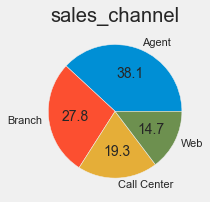

In [165]:
#不知道為什麼要先跑一張圖autoviz才會出現
channel=data['sales_channel'].value_counts()
s2=pd.Series(channel)

ax2=s2.plot.pie(autopct='%.1f')

ax2.set_title('sales_channel')
ax2.set_ylabel('')


fig1=ax2.figure
fig1.set_size_inches(8,3)
fig1.tight_layout(pad=1)
plt.show()

# 3.Visualization

In [22]:
!pip install autoviz

Alert! from autoviz version 0.1.35, after importing, you must %matplotlib inline to display charts in Jupyter Notebooks.
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Updated: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.
      chart_format='html' silently saves charts HTML format - they are also interactive!


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
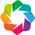

In [23]:
from autoviz.AutoViz_Class import AutoViz_Class
Vis=AutoViz_Class()

In [24]:
data2.to_csv('data2.csv')

Shape of your Data Set loaded: (8099, 55)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    55 Predictors classified...
        2 variables removed since they were ID or low-information variables
8 numeric variables in data exceeds limit, taking top 30 variables
Number of All Scatter Plots = 36
Could not draw wordcloud plot for effective_to_date
Could not draw wordcloud plot for validated_date
Time to run AutoViz = 42 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


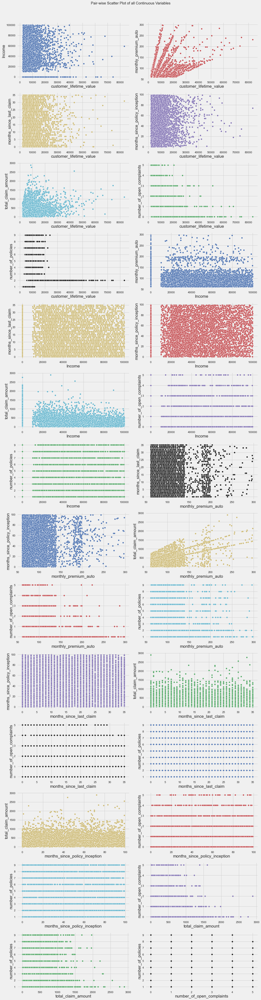

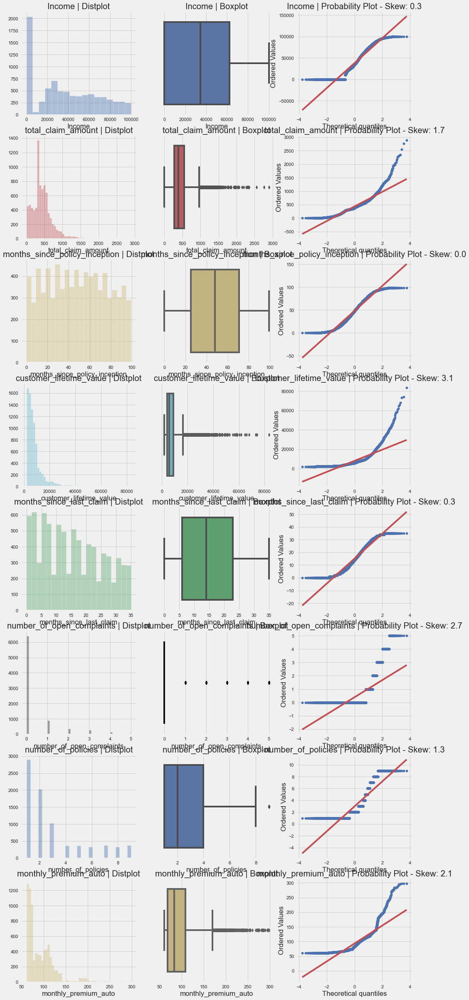

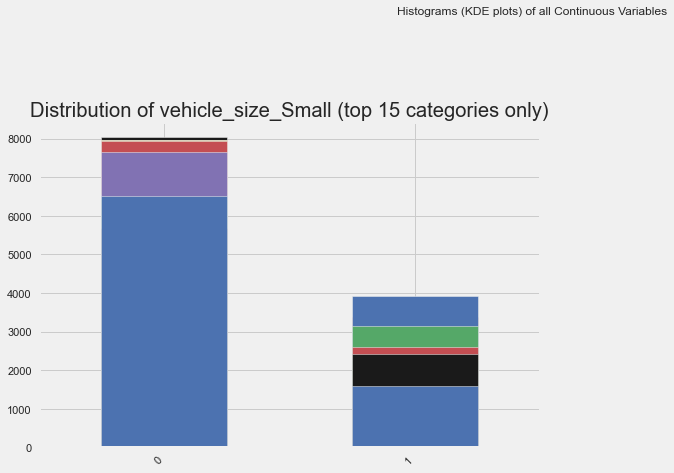

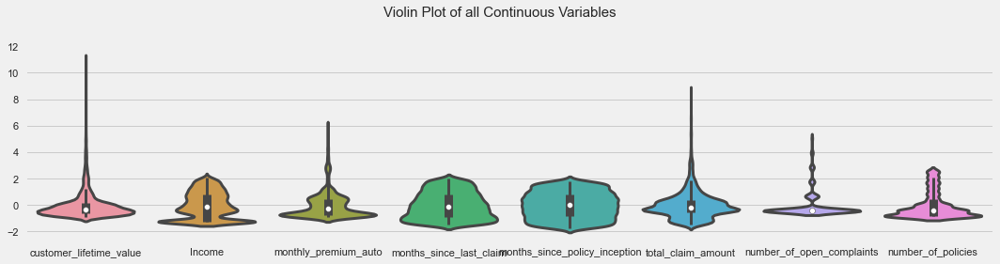

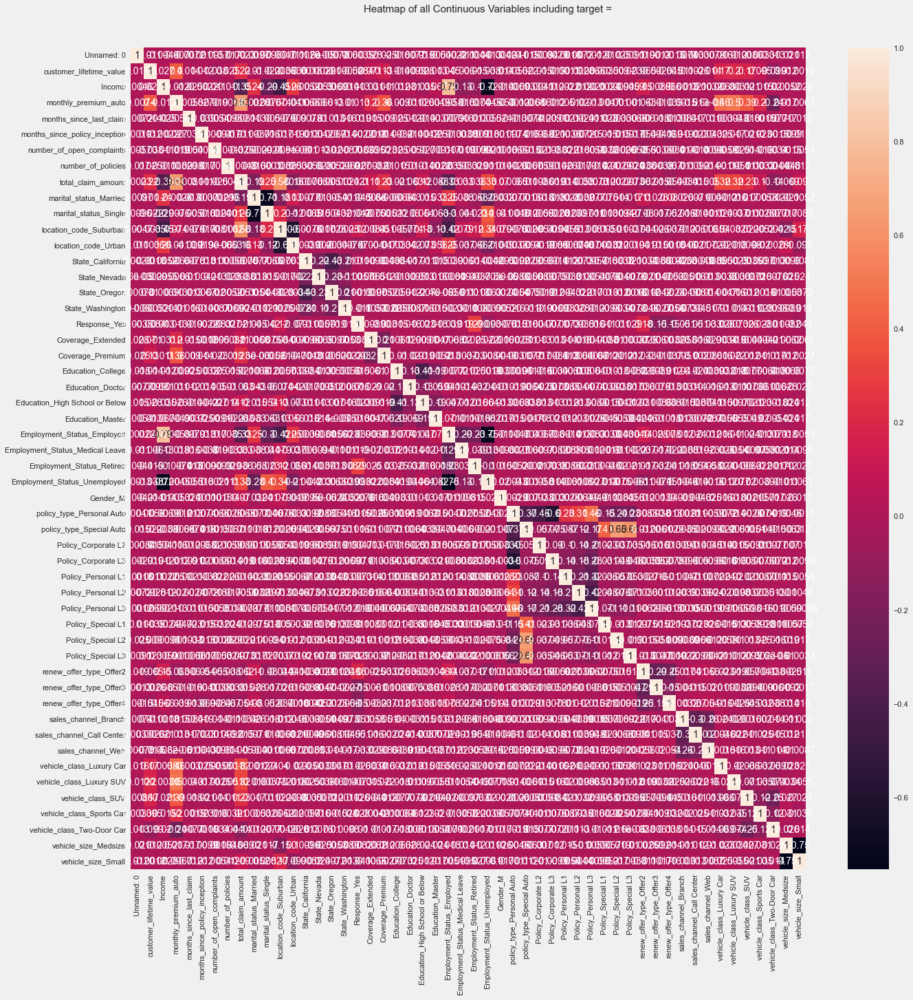

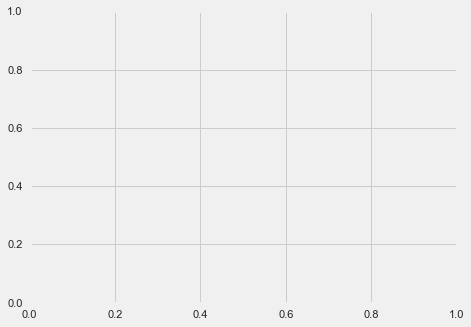

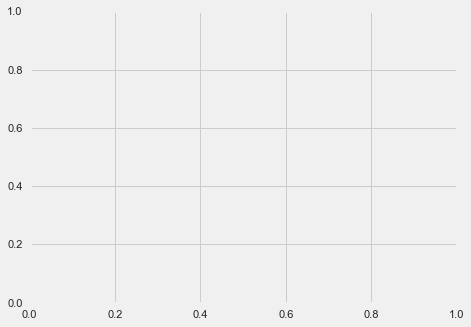

In [181]:
Vis_1=Vis.AutoViz('data2.csv')

# 4. Find the important relationship between variables

In [26]:
data2.corr()

,customer_lifetime_value,Income,monthly_premium_auto,months_since_last_claim,months_since_policy_inception,number_of_open_complaints,number_of_policies,total_claim_amount,marital_status_Married,marital_status_Single,...,sales_channel_Branch,sales_channel_Call Center,sales_channel_Web,vehicle_class_Luxury Car,vehicle_class_Luxury SUV,vehicle_class_SUV,vehicle_class_Sports Car,vehicle_class_Two-Door Car,vehicle_size_Medsize,vehicle_size_Small
customer_lifetime_value,1.000000,0.027449,0.396623,0.013663,0.012073,-0.037664,0.025158,0.216125,0.010229,-0.022417,...,0.010604,0.002565,-0.013568,0.174317,0.195581,0.174126,0.094831,-0.099107,0.011826,-0.001171
Income,0.027449,1.000000,-0.012027,-0.025153,-0.002163,0.011474,-0.010877,-0.351490,0.235674,-0.294497,...,-0.001321,0.020839,0.003188,0.006827,-0.003118,-0.021083,-0.015275,0.019853,0.005198,0.002773
monthly_premium_auto,0.396623,-0.012027,1.000000,0.005810,0.026723,-0.018642,-0.008168,0.626811,-0.002568,0.007552,...,0.001527,-0.012715,0.000056,0.462304,0.502655,0.385339,0.201538,-0.242089,0.017142,-0.006664
months_since_last_claim,0.013663,-0.025153,0.005810,1.000000,-0.038955,0.005379,0.009813,0.008116,0.013162,-0.005041,...,0.008352,0.016641,-0.011137,0.003013,0.004331,-0.018320,-0.001474,0.007707,0.016768,-0.011673
months_since_policy_inception,0.012073,-0.002163,0.026723,-0.038955,1.000000,0.000942,-0.017200,0.010808,-0.003742,-0.016374,...,0.019472,-0.022812,0.004318,0.024858,0.017246,-0.021100,0.022945,-0.001473,-0.009928,0.011559
number_of_open_complaints,-0.037664,0.011474,-0.018642,0.005379,0.000942,1.000000,-0.001298,-0.024729,-0.000291,-0.002419,...,-0.014347,0.001419,-0.009587,0.000579,-0.002483,-0.014393,-0.015971,0.003446,-0.001492,-0.005399
number_of_policies,0.025158,-0.010877,-0.008168,0.009813,-0.017200,-0.001298,1.000000,-0.004775,0.016143,0.000104,...,-0.010997,0.009244,0.014015,-0.001073,-0.005102,-0.011040,0.003153,-0.004377,0.004754,0.012284
total_claim_amount,0.216125,-0.351490,0.626811,0.008116,0.010808,-0.024729,-0.004775,1.000000,-0.193208,0.252511,...,-0.003359,-0.014805,0.004981,0.319213,0.317969,0.231597,0.100946,-0.141506,-0.068605,0.090490
marital_status_Married,0.010229,0.235674,-0.002568,0.013162,-0.003742,-0.000291,0.016143,-0.193208,1.000000,-0.712638,...,0.026034,0.007117,-0.004028,-0.001223,-0.015746,0.016743,0.000526,0.011750,-0.021099,-0.005231
marital_status_Single,-0.022417,-0.294497,0.007552,-0.005041,-0.016374,-0.002419,0.000104,0.252511,-0.712638,1.000000,...,-0.015875,-0.013842,-0.001061,0.024142,0.003691,-0.011349,0.002595,0.007721,0.017354,0.008208


In [27]:
#CLV和其他變數相關性
data2.corr()['customer_lifetime_value']

customer_lifetime_value            1.000000
Income                             0.027449
monthly_premium_auto               0.396623
months_since_last_claim            0.013663
months_since_policy_inception      0.012073
number_of_open_complaints         -0.037664
number_of_policies                 0.025158
total_claim_amount                 0.216125
marital_status_Married             0.010229
marital_status_Single             -0.022417
location_code_Suburban            -0.003451
location_code_Urban                0.003574
State_California                  -0.001813
State_Nevada                       0.000292
State_Oregon                       0.010008
State_Washington                  -0.000524
Response_Yes                      -0.008442
Coverage_Extended                  0.070944
Coverage_Premium                   0.131925
Education_College                 -0.013737
Education_Doctor                  -0.009939
Education_High School or Below     0.027511
Education_Master                

In [28]:
#賠償金額與其他變數的相關性
data2.corr()['total_claim_amount']

customer_lifetime_value            0.216125
Income                            -0.351490
monthly_premium_auto               0.626811
months_since_last_claim            0.008116
months_since_policy_inception      0.010808
number_of_open_complaints         -0.024729
number_of_policies                -0.004775
total_claim_amount                 1.000000
marital_status_Married            -0.193208
marital_status_Single              0.252511
location_code_Suburban             0.582621
location_code_Urban               -0.158616
State_California                   0.000754
State_Nevada                       0.008768
State_Oregon                       0.005064
State_Washington                   0.002443
Response_Yes                       0.020754
Coverage_Extended                  0.111183
Coverage_Premium                   0.230195
Education_College                 -0.021453
Education_Doctor                  -0.063259
Education_High School or Below     0.115989
Education_Master                

In [29]:
data2.corr()['vehicle_class_Luxury Car']

customer_lifetime_value            0.174317
Income                             0.006827
monthly_premium_auto               0.462304
months_since_last_claim            0.003013
months_since_policy_inception      0.024858
number_of_open_complaints          0.000579
number_of_policies                -0.001073
total_claim_amount                 0.319213
marital_status_Married            -0.001223
marital_status_Single              0.024142
location_code_Suburban             0.039965
location_code_Urban               -0.019975
State_California                   0.005034
State_Nevada                      -0.003279
State_Oregon                      -0.004671
State_Washington                   0.010456
Response_Yes                      -0.026460
Coverage_Extended                 -0.003419
Coverage_Premium                   0.016168
Education_College                  0.003248
Education_Doctor                  -0.012579
Education_High School or Below     0.014637
Education_Master                

In [30]:
data2.corr()['vehicle_class_Luxury SUV']

customer_lifetime_value            0.195581
Income                            -0.003118
monthly_premium_auto               0.502655
months_since_last_claim            0.004331
months_since_policy_inception      0.017246
number_of_open_complaints         -0.002483
number_of_policies                -0.005102
total_claim_amount                 0.317969
marital_status_Married            -0.015746
marital_status_Single              0.003691
location_code_Suburban             0.031594
location_code_Urban               -0.017860
State_California                   0.002489
State_Nevada                      -0.003592
State_Oregon                       0.015647
State_Washington                  -0.013997
Response_Yes                       0.007324
Coverage_Extended                  0.015173
Coverage_Premium                   0.021567
Education_College                 -0.018305
Education_Doctor                  -0.010920
Education_High School or Below     0.009727
Education_Master                

# 5. Find three business insights

In [31]:
data.describe()

,customer_lifetime_value,Income,monthly_premium_auto,months_since_last_claim,months_since_policy_inception,number_of_open_complaints,number_of_policies,total_claim_amount
count,8099.000000,8099.000000,8099.000000,8099.000000,8099.000000,8099.000000,8099.000000,8099.000000
mean,7981.271398,37843.544265,93.140758,15.071490,48.147549,0.389184,2.963823,431.464401
std,6847.287340,30370.556860,34.381153,10.086656,27.818744,0.914152,2.390357,286.706233
min,1898.007675,0.000000,61.000000,0.000000,0.000000,0.000000,1.000000,0.099007
25%,3974.498315,0.000000,68.000000,6.000000,25.000000,0.000000,1.000000,269.484578
50%,5780.182197,34430.000000,83.000000,14.000000,48.000000,0.000000,2.000000,383.167471
75%,8963.294993,62459.500000,109.000000,23.000000,71.000000,0.000000,4.000000,547.200000
max,83325.381190,99981.000000,298.000000,35.000000,99.000000,5.000000,9.000000,2893.239678


### 1. 銷售管道

In [32]:
#銷售管道&保險類型
channel_coverage=data.groupby(['sales_channel']).Coverage.value_counts()

In [33]:
channel_coverage=channel_coverage.unstack()

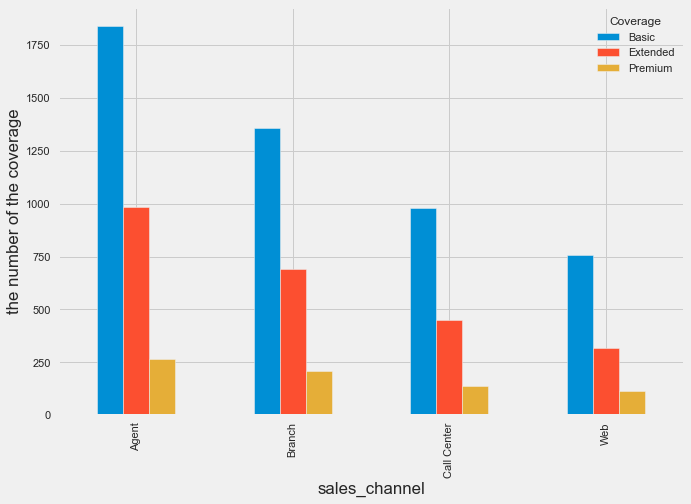

In [34]:
channel_coverage_plot=channel_coverage.plot(kind='bar',figsize=(10,7))
channel_coverage_plot.set_ylabel('the number of the coverage')

plt.show()

### 2. 調整保險內容

In [35]:
#保險內容更新
renew=data.groupby('Policy').renew_offer_type.value_counts()
renew

Policy        renew_offer_type
Corporate L1  Offer1               125
              Offer2                88
              Offer3                52
              Offer4                33
Corporate L2  Offer1               230
              Offer2               150
              Offer3                69
              Offer4                67
Corporate L3  Offer1               346
              Offer2               277
              Offer3               140
              Offer4               105
Personal L1   Offer1               458
              Offer2               356
              Offer3               191
              Offer4               119
Personal L2   Offer1               715
              Offer2               578
              Offer3               280
              Offer4               216
Personal L3   Offer1              1308
              Offer2              1016
              Offer3               477
              Offer4               339
Special L1    Offer1             

In [36]:
renew=renew.unstack()

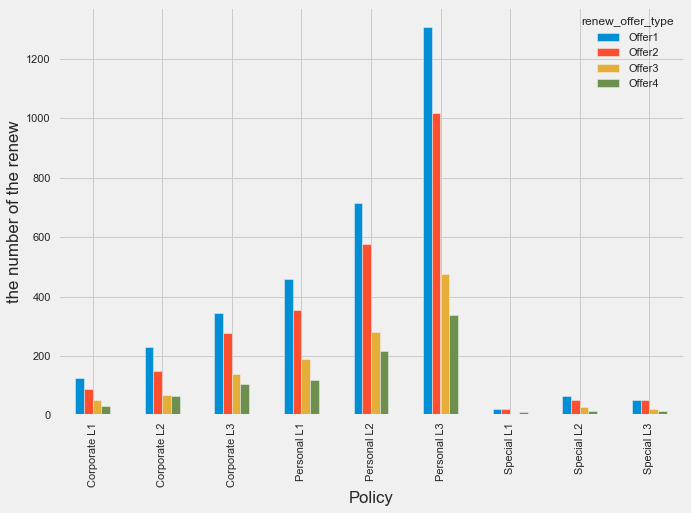

In [180]:
renew_plot=renew.plot(kind='bar',figsize=(10,7))
renew_plot.set_ylabel('the number of the renew')

plt.show()

### 3. 保險公司主要顧客群

In [162]:
#依據州劃分
state_location=data.groupby('State').location_code.value_counts()

<AxesSubplot:xlabel='State', ylabel='the number of people'>

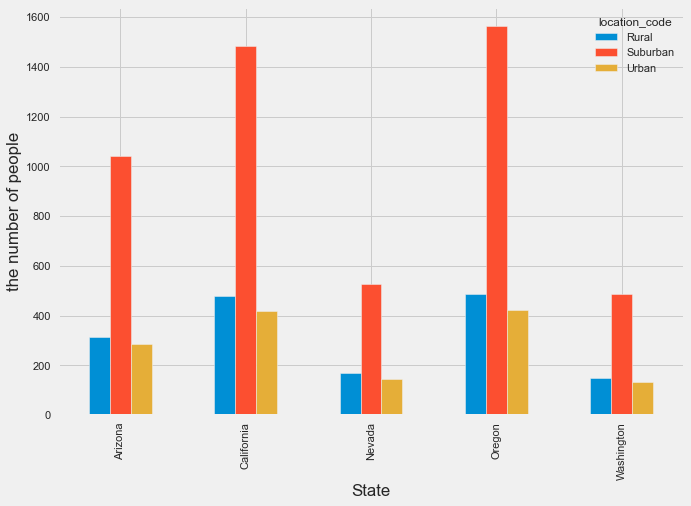

In [163]:
state_location=state_location.unstack()
state_location.plot(kind='bar',figsize=(10,7),ylabel='the number of people')

In [170]:
#依據居住類型劃分，了解保險類型及汽車種類對平均賠償金額
suburban=data[data['location_code']=='Suburban']
suburban

,Customer,State,customer_lifetime_value,Response,Coverage,Education,effective_to_date,Employment_Status,Gender,Income,...,number_of_open_complaints,number_of_policies,policy_type,Policy,renew_offer_type,sales_channel,total_claim_amount,vehicle_class,vehicle_size,validated_date
0,BU79786,Washington,2763.519279,No,Basic,Bachelor,2/24/2011,Employed,F,56274.0,...,0.0,1.0,Corporate Auto,Corporate L3,Offer1,Agent,384.811147,Two-Door Car,Medsize,2011-02-24
1,QZ44356,Arizona,6979.535903,No,Extended,Bachelor,1/31/2011,Unemployed,F,0.0,...,0.0,8.0,Personal Auto,Personal L3,Offer3,Agent,1131.464935,Four-Door Car,Medsize,2011-01-31
2,AI49188,Nevada,12887.431650,No,Premium,Bachelor,2/19/2011,Employed,F,48767.0,...,0.0,2.0,Personal Auto,Personal L3,Offer1,Agent,566.472247,Two-Door Car,Medsize,2011-02-19
3,WW63253,California,7645.861827,No,Basic,Bachelor,1/20/2011,Unemployed,M,0.0,...,0.0,7.0,Corporate Auto,Corporate L2,Offer1,Call Center,529.881344,SUV,Medsize,2011-01-20
6,XZ87318,Oregon,5380.898636,Yes,Basic,College,2/24/2011,Employed,F,55350.0,...,0.0,9.0,Corporate Auto,Corporate L3,Offer1,Agent,321.600000,Four-Door Car,Medsize,2011-02-24
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8088,DU39756,Nevada,4170.687348,Yes,Basic,Master,1/17/2011,Employed,F,29462.0,...,1.0,1.0,Corporate Auto,Corporate L2,Offer2,Branch,513.600000,SUV,Large,2011-01-17
8092,YJ57293,California,2776.842204,No,Extended,College,2/4/2011,Medical Leave,M,23830.0,...,1.0,1.0,Corporate Auto,Corporate L3,Offer4,Web,364.800000,Two-Door Car,Medsize,2011-02-04
8093,BV22194,Arizona,14194.154410,No,Basic,High School or Below,2/13/2011,Employed,F,88178.0,...,0.0,2.0,Personal Auto,Personal L3,Offer2,Call Center,336.000000,Two-Door Car,Medsize,2011-02-13
8094,UH22701,Oregon,9726.551005,No,Extended,Master,1/1/2011,Employed,F,72236.0,...,0.0,2.0,Personal Auto,Personal L3,Offer2,Call Center,518.064733,Four-Door Car,Medsize,2011-01-01


In [173]:
suburban.groupby(['Coverage','vehicle_class']).customer_lifetime_value.mean()

Coverage  vehicle_class
Basic     Four-Door Car     5700.755608
          Luxury Car       13233.654746
          Luxury SUV       15841.431701
          SUV               9868.900044
          Sports Car        9999.846135
          Two-Door Car      5808.435060
Extended  Four-Door Car     7252.069813
          Luxury Car       23662.262126
          Luxury SUV       20006.061449
          SUV               9804.620607
          Sports Car       10025.011847
          Two-Door Car      7098.926408
Premium   Four-Door Car     9818.088239
          Luxury Car       16274.745681
          Luxury SUV       15830.222948
          SUV              13782.771431
          Sports Car       12217.825794
          Two-Door Car      8122.359854
Name: customer_lifetime_value, dtype: float64

In [177]:
employment=suburban.groupby(['Employment_Status']).total_claim_amount.mean()

<AxesSubplot:xlabel='Employment_Status', ylabel='average claim'>

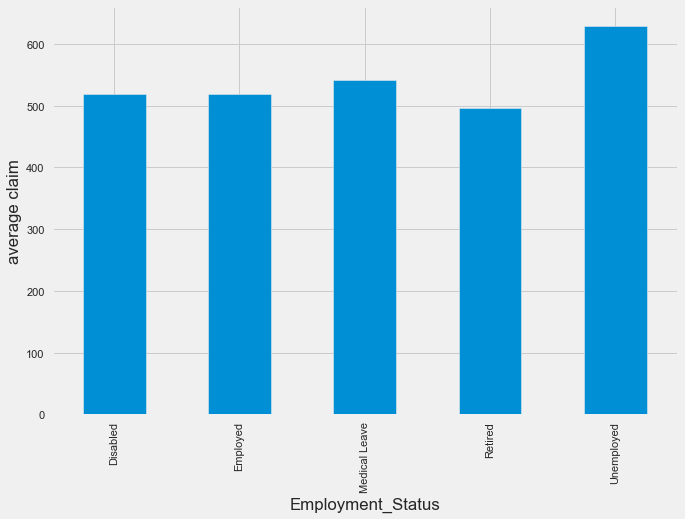

In [179]:
employment.plot(kind='bar',figsize=(10,7),ylabel='average claim')

### 4.主要客戶: 前25% 顧客終身價值的被保人

In [38]:
#了解前25%被保人概況
potential_customer=data[data['customer_lifetime_value']>8963.294993]
potential_customer

,Customer,State,customer_lifetime_value,Response,Coverage,Education,effective_to_date,Employment_Status,Gender,Income,...,number_of_open_complaints,number_of_policies,policy_type,Policy,renew_offer_type,sales_channel,total_claim_amount,vehicle_class,vehicle_size,validated_date
2,AI49188,Nevada,12887.431650,No,Premium,Bachelor,2/19/2011,Employed,F,48767.0,...,0.0,2.0,Personal Auto,Personal L3,Offer1,Agent,566.472247,Two-Door Car,Medsize,2011-02-19
8,DY87989,Oregon,24127.504020,Yes,Basic,Bachelor,1/26/2011,Medical Leave,M,14072.0,...,0.0,2.0,Corporate Auto,Corporate L3,Offer1,Agent,511.200000,Four-Door Car,Medsize,2011-01-26
22,YH23384,Arizona,24127.504020,Yes,Basic,Bachelor,1/26/2011,Medical Leave,M,14072.0,...,0.0,2.0,Personal Auto,Personal L3,Offer1,Agent,511.200000,Four-Door Car,Medsize,2011-01-26
28,GE62437,Arizona,12902.560140,No,Premium,College,2/2/2011,Employed,F,86584.0,...,2.0,2.0,Personal Auto,Personal L3,Offer1,Call Center,532.800000,Four-Door Car,Large,2011-02-02
31,UL64533,Nevada,18975.456110,No,Extended,High School or Below,1/22/2011,Employed,M,65999.0,...,0.0,6.0,Corporate Auto,Corporate L2,Offer2,Agent,615.927769,Luxury SUV,Medsize,2011-01-22
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8084,QH87479,Oregon,27528.311320,No,Extended,High School or Below,1/6/2011,Employed,F,54586.0,...,0.0,2.0,Personal Auto,Personal L2,Offer3,Branch,122.590766,Two-Door Car,Large,2011-01-06
8089,GY65868,California,20600.239580,No,Extended,Bachelor,2/18/2011,Employed,M,64541.0,...,0.0,2.0,Personal Auto,Personal L3,Offer3,Agent,256.279637,Four-Door Car,Small,2011-02-18
8093,BV22194,Arizona,14194.154410,No,Basic,High School or Below,2/13/2011,Employed,F,88178.0,...,0.0,2.0,Personal Auto,Personal L3,Offer2,Call Center,336.000000,Two-Door Car,Medsize,2011-02-13
8094,UH22701,Oregon,9726.551005,No,Extended,Master,1/1/2011,Employed,F,72236.0,...,0.0,2.0,Personal Auto,Personal L3,Offer2,Call Center,518.064733,Four-Door Car,Medsize,2011-01-01


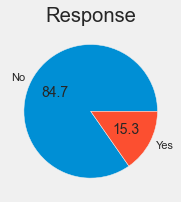

In [39]:
#前25%被保人申報次數
potential_response=potential_customer['Response'].value_counts()
r=pd.Series(potential_response)

response=r.plot.pie(autopct='%.1f')

response.set_title('Response')
response.set_xlabel('')
response.set_ylabel('')

fig=response.figure
fig.set_size_inches(8,3)
fig.tight_layout(pad=1)
plt.show()

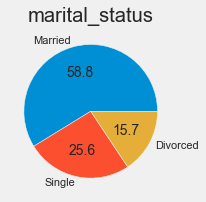

In [40]:
#婚姻狀態
potential_marital=potential_customer['marital_status'].value_counts()
m=pd.Series(potential_marital)

marital=m.plot.pie(autopct='%.1f')

marital.set_title('marital_status')
marital.set_xlabel('')
marital.set_ylabel('')

fig=marital.figure
fig.set_size_inches(8,3)
fig.tight_layout(pad=1)
plt.show()

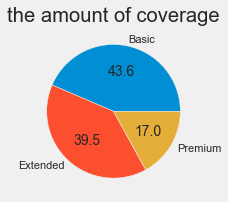

In [41]:
#前25%被保人的保險類型
potential_coverage=potential_customer['Coverage'].value_counts()
c=pd.Series(potential_coverage)

coverage=c.plot.pie(autopct='%.1f')

coverage.set_title('the amount of coverage')
coverage.set_xlabel('')
coverage.set_ylabel('')

fig=coverage.figure
fig.set_size_inches(8,3)
fig.tight_layout(pad=1)
plt.show()

In [42]:
#前25%被保人的婚姻狀態及教育程度
potential_customer_marital=potential_customer.groupby(['marital_status','Education']).customer_lifetime_value.mean()

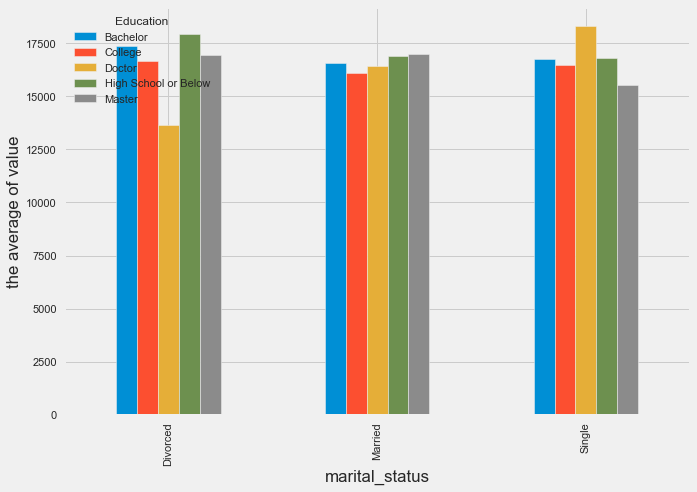

In [43]:
potential_customer_marital=potential_customer_marital.unstack()
potential_customer_marital.plot(kind='bar',figsize=(10,7), ylabel='the average of value')
plt.show()

In [44]:
#前25%被保人保險類型及汽車種類
potential_customer_coverage_car=potential_customer.groupby(['Coverage','vehicle_class']).customer_lifetime_value.mean()

In [45]:
potential_customer_coverage_car=potential_customer_coverage_car.unstack()

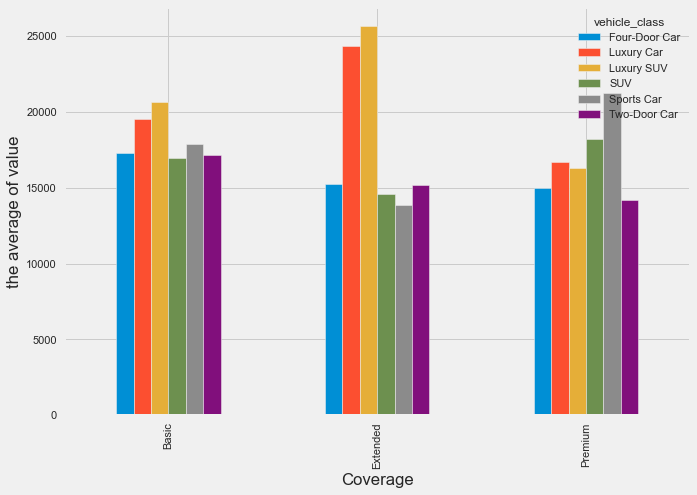

In [46]:
potential_customer_coverage_car.plot(kind='bar',figsize=(10,7), ylabel='the average of value')
plt.show()

In [161]:
potential_customer.corr()['monthly_premium_auto']

customer_lifetime_value          0.132898
Income                          -0.011710
monthly_premium_auto             1.000000
months_since_last_claim          0.017048
months_since_policy_inception    0.069641
number_of_open_complaints       -0.030863
number_of_policies               0.317339
total_claim_amount               0.671895
Name: monthly_premium_auto, dtype: float64